# AutoCycle

This notebook calculates optimized routes covering up to 26 public bicycle stations in Houston, allowing us to visit all of them with mimimal effort. It produces an overview figure, a figure for each route, and a webpage which lists the waypoints to be visited in order.

Most useful, perhaps, is a table on each webpage which has links for each station, launching Google or Apple maps directions to each station according to its GPS coordinates. This enables a very casual navigation flow when riding to all the stations.

In [59]:
import dbfread, simpledbf
import geopandas as gpd
import tilemapbase
import matplotlib
import json
import hashlib
import os
import pickle
import requests
from urllib.parse import quote
import urllib.parse
import pickle

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import jinja2

In [60]:
json_data = json.load(open('token.json','r'))
API_KEY = json_data['API_KEY']

## Helper Functions

In [61]:
def decode_polyline(polyline_str):
    index, lat, lng = 0, 0, 0
    coordinates = []
    changes = {'latitude': 0, 'longitude': 0}

    # Coordinates have variable length when encoded, so just keep
    # track of whether we've hit the end of the string. In each
    # while loop iteration, a single coordinate is decoded.
    while index < len(polyline_str):
        # Gather lat/lon changes, store them in a dictionary to apply them later
        for unit in ['latitude', 'longitude']: 
            shift, result = 0, 0

            while True:
                byte = ord(polyline_str[index]) - 63
                index+=1
                result |= (byte & 0x1f) << shift
                shift += 5
                if not byte >= 0x20:
                    break

            if (result & 1):
                changes[unit] = ~(result >> 1)
            else:
                changes[unit] = (result >> 1)

        lat += changes['latitude']
        lng += changes['longitude']

        coordinates.append((lat / 100000.0, lng / 100000.0))

    return coordinates


In [62]:
# Begin a cache of open source map tiles
tilemapbase.init(create=True)

## Show each neighborhood separately

In [84]:
data = pd.read_csv('houston_stations.tsv', delimiter='\t')

In [85]:
# Find the northeast and southwest corners of a collection of stations
def find_bounds(stations):
    ne = [None, None]
    sw = [None, None]
    for idx, row in stations.iterrows():
        if ne[0] is None or row['Lat'] > ne[0]:
            ne[0] = row['Lat']
        if ne[1] is None or row['Lon'] > ne[1]:
            ne[1] = row['Lon']
        
        if sw[0] is None or row['Lat'] < sw[0]:
            sw[0] = row['Lat'] 
        if sw[1] is None or row['Lon'] < sw[1]:
            sw[1] = row['Lon']
            
    return ne, sw

In [87]:
df = data[['Name','N2','Lat','Lon']]
df

,Name,N2,Lat,Lon
0,Lamar & Bagby,Downtown,29.759830,-95.369490
1,Clay & Smith,Downtown,29.756160,-95.371120
2,Crawford Island,Downtown,29.754440,-95.359200
3,Downtown Transit Center METRORail,Downtown,29.749769,-95.370729
4,Jury Assembly,Downtown,29.761610,-95.358020
...,...,...,...,...
152,Rusk & St. Emanuel,NONE,29.752730,-95.354190
153,MacGregor Park,NONE,29.710170,-95.340250
154,Louisiana & Walker,Downtown,29.759511,-95.366975
155,Winpark / Four Oaks,Memorial (Park),29.752519,-95.459950


In [66]:
def plot_N2(df):
    # Get bounds
    ne, sw = find_bounds(df2)
    
    # Plot extents
    b1 = {'lat': ne[0], 'lng': ne[1]}
    b2 = {'lat': sw[0], 'lng': sw[1]}
    
    lng_diff = abs(b1['lng']-b2['lng'])
    lat_diff = abs(b1['lat']-b2['lat'])
    frac = 0.1

    # Get lat/long with an added margin
    extent = tilemapbase.Extent.from_lonlat(b2['lng']-lng_diff*frac, b1['lng']+lng_diff*frac,
                                            b2['lat']-lat_diff*frac, b1['lat']+lat_diff*frac, )
    
    fig, ax = plt.subplots(figsize=(10,10))

    plotter = tilemapbase.Plotter(extent, tilemapbase.tiles.build_OSM(), width=600)
    plotter.plot(ax)
    
    # Scatterplot stations
    path = [tilemapbase.project(x,y) for x,y in zip(df.Lon, df.Lat)]
    path_T = np.array(path).T
    plt.scatter(path_T[0], path_T[1], color='r')
    for n,(x,y) in enumerate(path_T.T):
        plt.text(x,y,n+1, size=36)

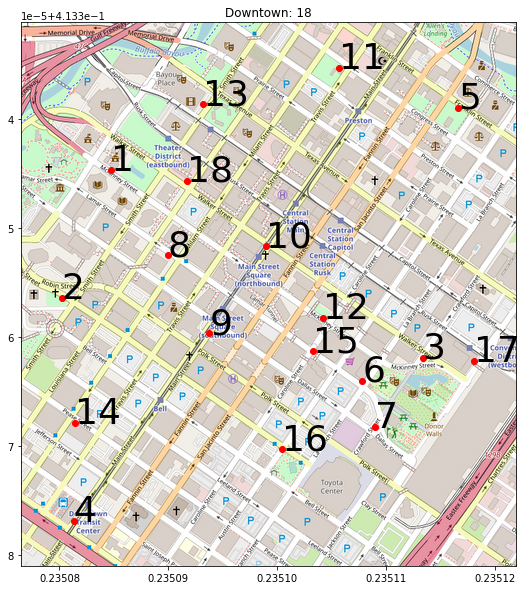

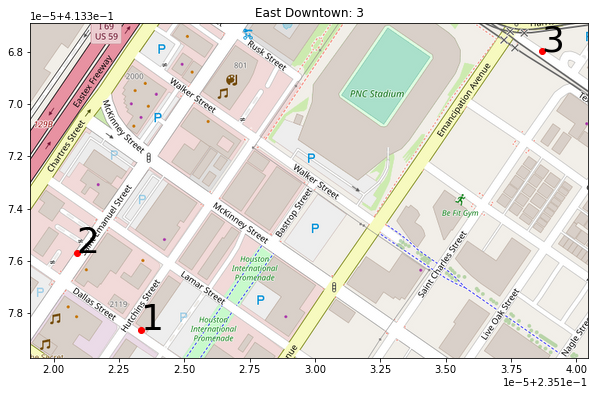

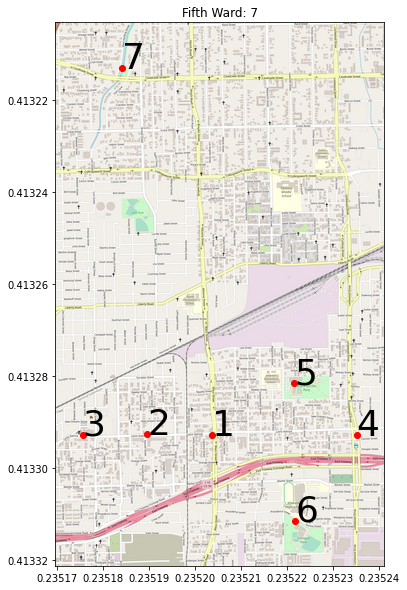

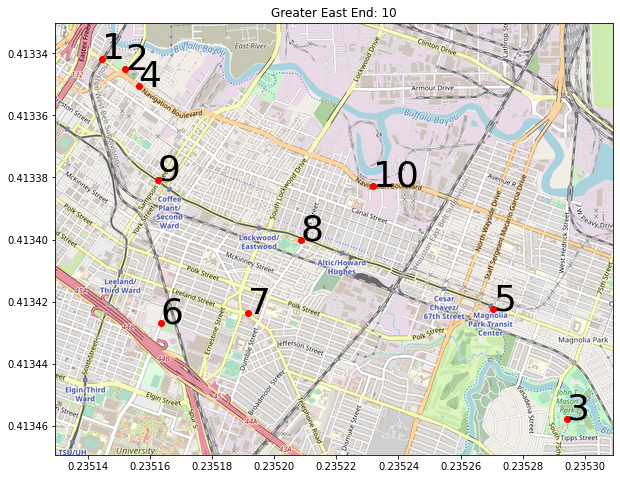

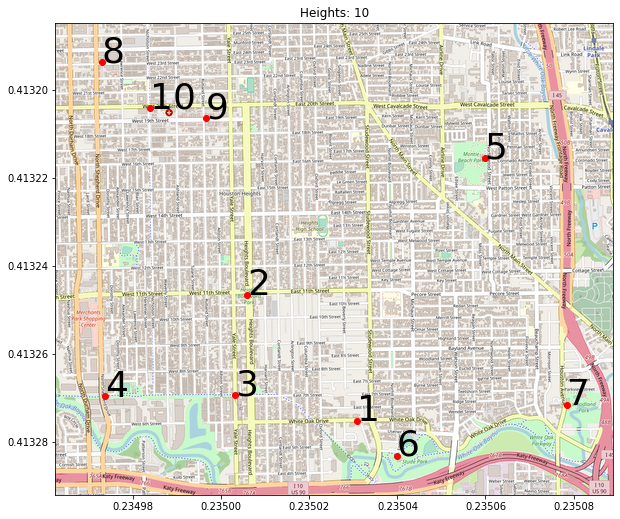

...

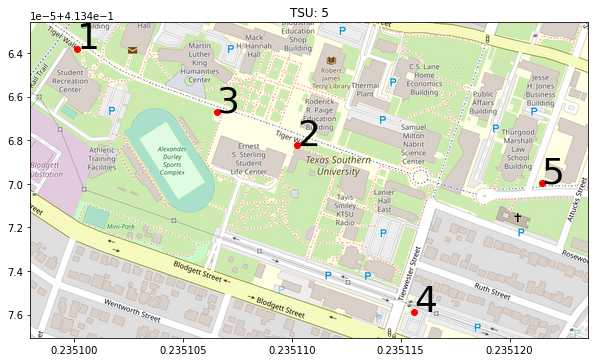

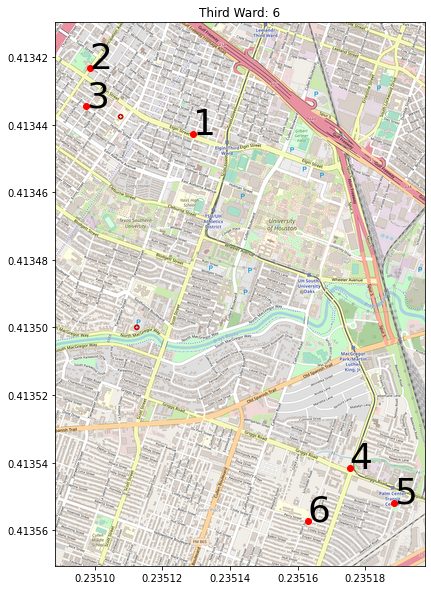

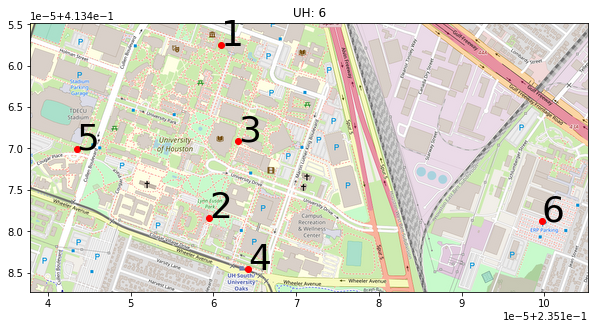

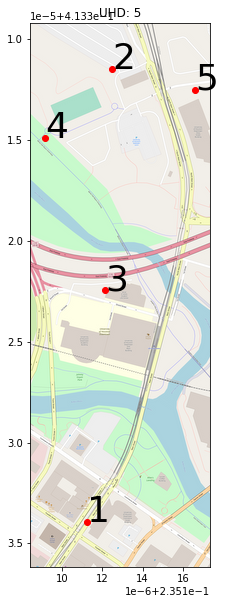

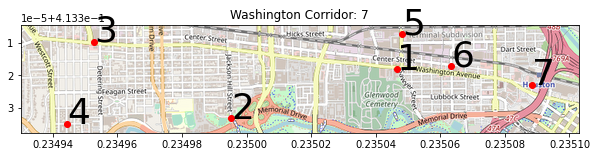

In [67]:
found_bounds = {}

# Make a scatterplot of each major neighborhood group (N2)
# These are unordered -- waypoints will be prioritized later
for idx, df2 in df.groupby('N2'):
    ne, sw = find_bounds(df2)
    found_bounds[idx] = [ne, sw]
    if len(df2) > 1:
        plot_N2(df2)
        plt.title("%s: %d" % (idx, len(df2)))
        plt.show()

## Make full-extent map

In [68]:
# Calculate bounds for a full-extent map of the entire city
# But some neighborhoods are outliers, and unnecessarily expand map
outlier_list = ['Memorial City', 'Lake Houston','NONE']
df_total = pd.DataFrame()
df_total['Lat'] = [val[0][0] for key,val in found_bounds.items() if key not in outlier_list] + [val[1][0] for key,val in found_bounds.items() if key not in outlier_list] 
df_total['Lon'] = [val[0][1] for key,val in found_bounds.items() if key not in outlier_list] + [val[1][1] for key,val in found_bounds.items() if key not in outlier_list] 

total_ne, total_sw = find_bounds(df_total)
ne = total_ne
sw = total_sw
b1 = {'lat': ne[0], 'lng': ne[1]}
b2 = {'lat': sw[0], 'lng': sw[1]}

lng_diff = abs(b1['lng']-b2['lng'])
lat_diff = abs(b1['lat']-b2['lat'])
frac = 0.1

super_extent = tilemapbase.Extent.from_lonlat(b2['lng']-lng_diff*frac, b1['lng']+lng_diff*frac,
                                        b2['lat']-lat_diff*frac, b1['lat']+lat_diff*frac, )
print('extent:', super_extent)


extent: Extent((0.23471688696388893,0.4131515550300814)->(0.2353466557305556,0.4136572128939542) projected as normal)


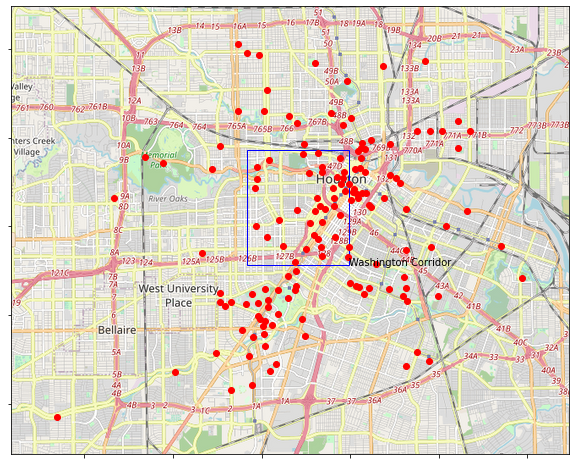

In [88]:
# Plot full-extent map
fig, ax = plt.subplots(figsize=(10,10))

plotter = tilemapbase.Plotter(super_extent, tilemapbase.tiles.build_OSM(), width=600)
plotter.plot(ax)

# Add rectangle for neighborhood
for n2 in found_bounds:
    
    # Skip outlier neighborhoods
    if n2 in outlier_list: continue
    
    
    ne, sw = found_bounds[n2]
    b1 = {'lat': ne[0], 'lng': ne[1]}
    b2 = {'lat': sw[0], 'lng': sw[1]}

    lng_diff = abs(b1['lng']-b2['lng'])
    lat_diff = abs(b1['lat']-b2['lat'])
    frac = 0.1

    extent_r = tilemapbase.Extent.from_lonlat(b2['lng']-lng_diff*frac, b1['lng']+lng_diff*frac,
                                            b2['lat']-lat_diff*frac, b1['lat']+lat_diff*frac, )

    ax.add_patch(matplotlib.patches.Rectangle((extent_r._xmin, extent_r._ymin), 
                    extent_r._xmax-extent_r._xmin, extent_r._ymax-extent_r._ymin, 
                    angle=0.0, color='blue', fill=False))

    plt.text(extent_r._xmax, extent_r._ymax, n2)

# Scatterplot the stations
df_close = df[~df['N2'].isin(outlier_list)]
path = [tilemapbase.project(x,y) for x,y in zip(df_close.Lon, df_close.Lat)]
path_T = np.array(path).T
plt.scatter(path_T[0], path_T[1], color='r')

ax.set_yticklabels([])
ax.set_xticklabels([])

plt.savefig('web/images/big.jpg', dpi=600, bbox_inches='tight')

## Define super-sized circuits

It makes sense to combine some neighborhoods together to make larger circuits, so that trips are more efficient. You can define your own if you have another preference.

In [70]:
# Groups of neighborhoods
group1 = ['Near Northside', 'Fifth Ward', 'UHD'] # Heights is a special ride
group2 = ['TMC','Rice University',] # 'Hermann Park','Museum District' is a special ride
group3 = ['TSU','UH', 'Third Ward'] 
group4 = ['Downtown', 'East Downtown']

group5 = ['Greater East End', 'Inner Loop SW','Lake Houston', 'NONE', 'Memorial City'] # exclusions (sparse)
group6 = ['Hermann Park', 'Museum District', 'Memorial (Park)', 'Heights'] # Special rides

group7 = ['Midtown', 'Montrose']

group8 = ['Washington Corridor']

# Another definition of groups of groups
mega_groups = [
    ['Near Northside', 'Fifth Ward', 'UHD'],
    ['TMC','Rice University',],
    ['TSU','UH', 'Third Ward',],
    ['Downtown', 'East Downtown',],
    ['Midtown', 'Montrose',],
]

sparse_groups = [
    ['Greater East End',],
    ['Inner Loop SW',],
    ['Lake Houston', ],
    ['Memorial City',],
    ['Washington Corridor',],
]

# Some stations are being removed
invalid_groups = ['NONE',]


special_groups = [
    ['Heights',],
    ['Museum District', 'Hermann Park'],
    ['Memorial (Park)']
]

In [71]:
# Check for unaccounted for stations
[_ for _ in df.N2.unique() if _ not in np.sum([group1,group2,group3, group4, group5, group6, group7, group8])]

/usr/local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


[]

# Let's roll

## Mega Groups

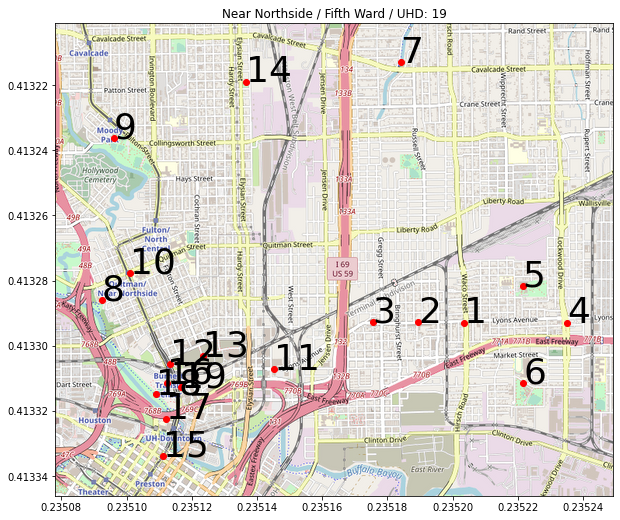

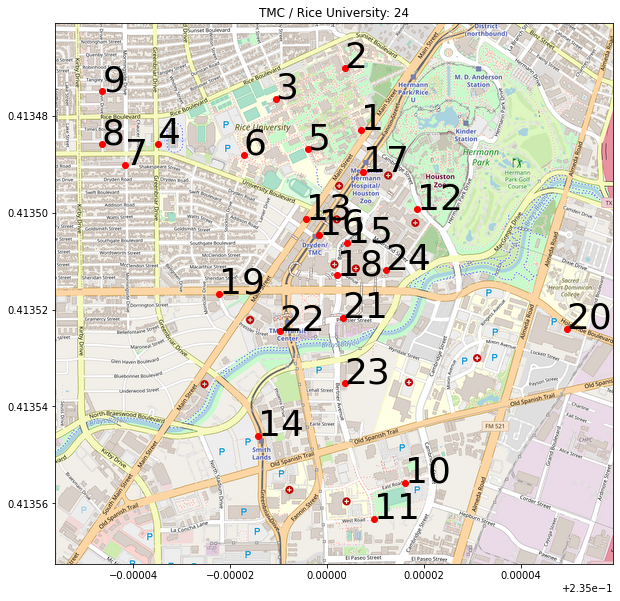

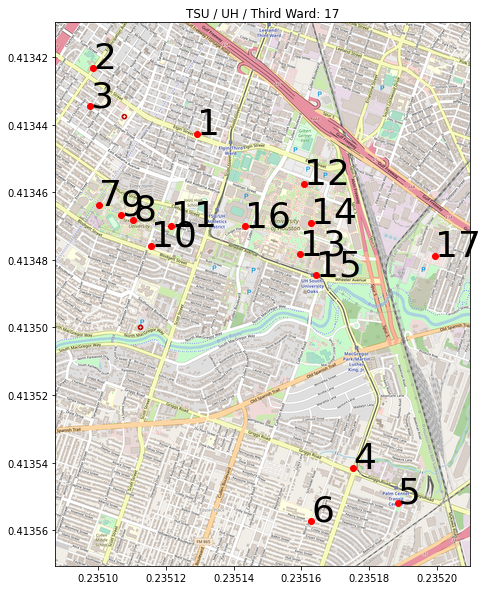

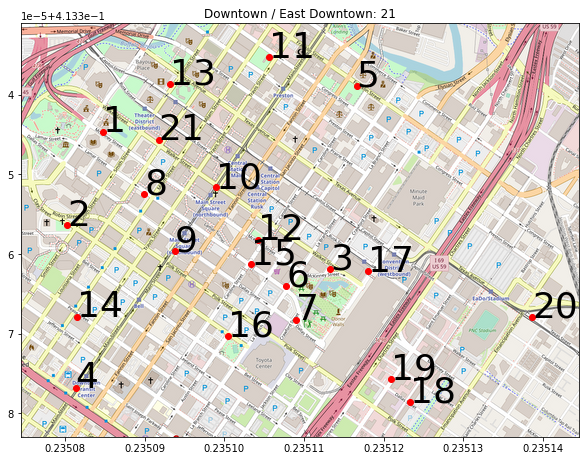

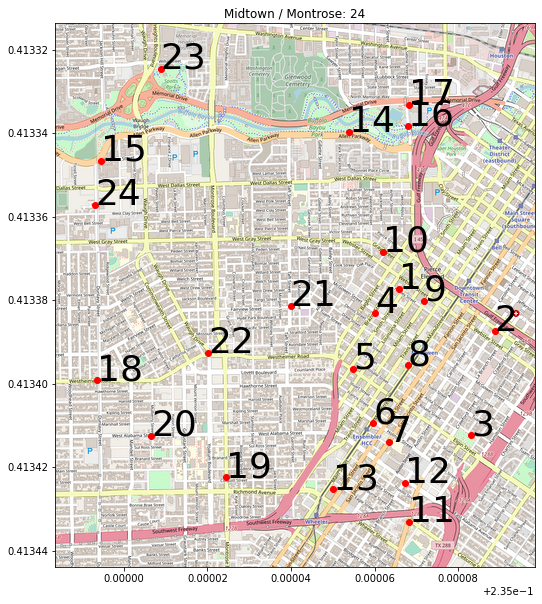

In [72]:
# Check that mega groups make sense before we do routing
for group in mega_groups:
    found_bounds = {}
    df2 = df[df.N2.isin(group)]    

    ne, sw = find_bounds(df2)
    found_bounds[idx] = [ne, sw]
    #     print('\t',ne,sw)
    if len(df2) > 1:
        plot_N2(df2)
        plt.title("%s: %d" % (' / '.join(group), len(df2)))
        
        plt.show()

# Let's do some routing

In [73]:
# Utility function for caching expensive routing results
def get_hash(thing):
    return hashlib.md5(json.dumps(thing).encode('utf-8')).digest().hex()

# The original ordering of stations is not meaningful. We permute them using
# the results from the google query
def permute_stations(df, waypoint_order):
    
    # Order them by latitute to start
    all_idx = list(range(len(df)))
    all_idx = list(sorted(all_idx, key=lambda x: df.iloc[x]['Lat']))
    
    start_stop = all_idx[0]
    
    all_idx = all_idx[1:]
    
    final_ordering = [start_stop,]  + [all_idx[m] for m in waypoint_order] + [0,]
    listed = [_ for idx,_ in df.iterrows()]
    ordered = [listed[m] for m in final_ordering]
    
    return ordered    

os.makedirs('bcycle_data',exist_ok=True)

In [90]:
# When given a dataframe with stations, obtain optimized route and save figure
def obtain_and_plot_waypoints(df, debug=False, force=False, label=None):
    
    start_idx = 0
    end_idx = 0
       
    # Get longitude and latitude for all stations in the circuit
    waypts_latlong = np.array([df['Lat'], df['Lon']]).T
    waypts_latlong = list(sorted(waypts_latlong, key=lambda x: x[0]))
    
    # Remove the starting (ending) station
    selected_waypts = [waypts_latlong[idx] for idx in range(len(waypts_latlong)) if idx not in [start_idx, end_idx]] 
    
    # Join the waypoints together in a url string
    joined_waypts = '|'.join([urllib.parse.quote('%s,%s' % (x[0],x[1])) for x in selected_waypts])
    
    # Make origin and destination url strings
    origin = urllib.parse.quote(str(waypts_latlong[start_idx][0])+','+str(waypts_latlong[start_idx][1]))
    destination = urllib.parse.quote(str(waypts_latlong[end_idx][0])+','+str(waypts_latlong[end_idx][1]))

    # Build full query
    query = f'https://maps.googleapis.com/maps/api/directions/json?origin={origin}&mode=bicycling&destination={destination}&waypoints=optimize:true|{joined_waypts}&key={API_KEY}'
    if debug: print(query, len(query))
    if debug: print(len(waypts_latlong))

    # Get hash for caching
    hashed = get_hash({
        'waypts_latlong': [(_[0], _[1]) for _ in waypts_latlong],
        'origin': origin,
        'destination': destination,
    })
    
    # Request optimized route or load cached route if it exists
    if force or not os.path.isfile(f'bcycle_data/{hashed}.req'):
        print('executing', hashed)
        opt_res = requests.post(example_query, timeout=30)
        if debug: print(opt_res.json())

        data = opt_res.json()

        pickle.dump(data, open(f'bcycle_data/{hashed}.req','wb'))    
    else:
        print('loading cache', hashed)
        data = pickle.load(open(f'bcycle_data/{hashed}.req','rb'))

    # Calculate total time and distance
    total_dist = 0
    total_dur = 0
    for leg in data['routes'][0]['legs']:
        dist = sum([int(step['distance']['value']) for step in leg['steps']])
        dur = sum([int(step['duration']['value']) for step in leg['steps']])

        if debug: print('distance: %d meters'  % dist, 'duration: %d seconds' % dur)
        total_dist += dist
        total_dur += dur

    print('Total distance: %0.3f mi' % (total_dist/1000.0*0.621371))
    print('Total duration: %d minutes' % (total_dur/60.0))
    
    # Calculate bounds / extent of this set of stations
    b1 = data['routes'][0]['bounds']['southwest']
    b2 = data['routes'][0]['bounds']['northeast']
    
    lng_diff = abs(b1['lng']-b2['lng'])
    lat_diff = abs(b1['lat']-b2['lat'])
    frac = 0.1

    extent = tilemapbase.Extent.from_lonlat(b1['lng']-lng_diff*frac,b2['lng']+lng_diff*frac, 
                                            b1['lat']-lat_diff*frac, b2['lat']+lat_diff*frac)
    
    # Create figure
    fig, ax = plt.subplots(figsize=(14,14))
    plotter = tilemapbase.Plotter(extent, tilemapbase.tiles.build_OSM(), width=600)
    plotter.plot(ax)
    plotter.plot(plt.axes())

    # Add stations, numbered
    counter = 0
    for leg in data['routes'][0]['legs']:

        counter += 1
        leg_steps = None
        for step in leg['steps']:

            pts = decode_polyline(step['polyline']['points'])

            if leg_steps is None:
                leg_steps = pts
            else:
                leg_steps = np.vstack([leg_steps, pts])

        pts_T = np.array(leg_steps).T

        longs = pts_T[1]
        lats = pts_T[0]

        # Convert lat/long to web mercator
        path = [tilemapbase.project(x,y) for x,y in zip(longs, lats)]
        x, y = zip(*path)

        # Plot path between stations for a leg
        plt.plot(x,y, linewidth=6)

        if counter >= 0:
            plt.text(x[0],y[0],str(counter), size=36)

    N_covered = df.N2.unique()
    plt.title(label + ': '+' / '.join(N_covered) + ': %d legs, distance %0.1f mi, duration %d minutes'  % (counter, total_dist / 1000* 0.621371, total_dur // 60))

    ax.set_yticklabels([])
    ax.set_xticklabels([])
    
    if label is not None:
        print('saving', label)
        plt.savefig(f'web/images/{label}.jpg', dpi=480,  bbox_inches='tight')

    return total_dist/1000.0*0.621371, total_dur/60.0, len(data['routes'][0]['legs']), data['routes'][0]['waypoint_order']
        

loading cache 9806ee35f0422ba50a4dc1da032b3f53
Total distance: 14.134 mi
Total duration: 83 minutes
saving mega_0
loading cache ca657ec2241ec4e538f31b7b20b3c2fd
Total distance: 13.165 mi
Total duration: 75 minutes
saving mega_1
loading cache 3dec2ada995a85fc0c4008c9df9cea47
Total distance: 13.287 mi
Total duration: 73 minutes
saving mega_2
loading cache 70752e4d7795adf8ec210a0db873dc8b
Total distance: 7.989 mi
Total duration: 54 minutes
saving mega_3
loading cache 0e8c30511fe6e83004963edeb4ea28cb
Total distance: 14.620 mi
Total duration: 92 minutes
saving mega_4


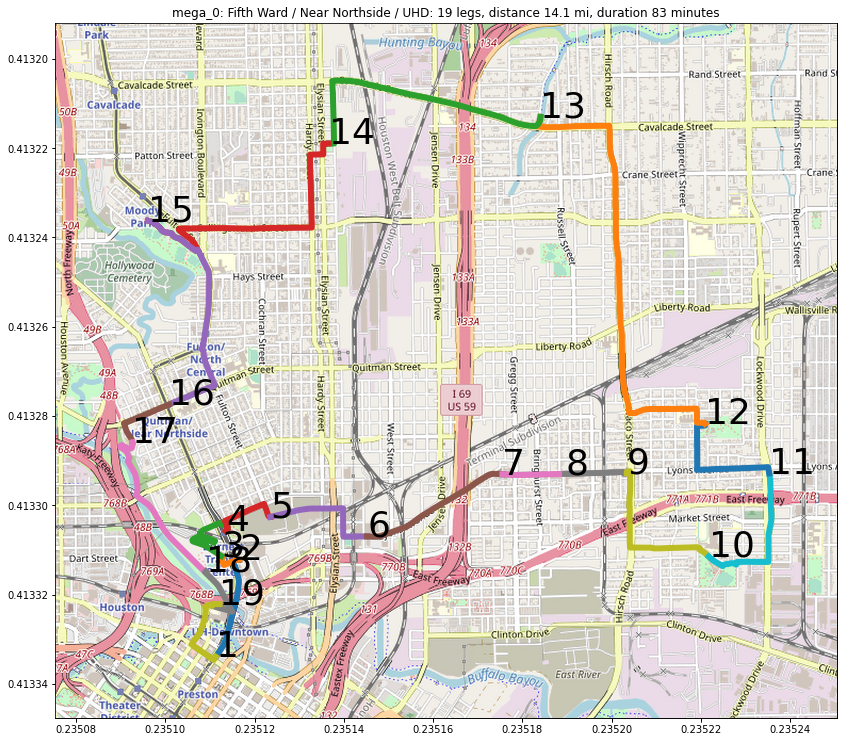

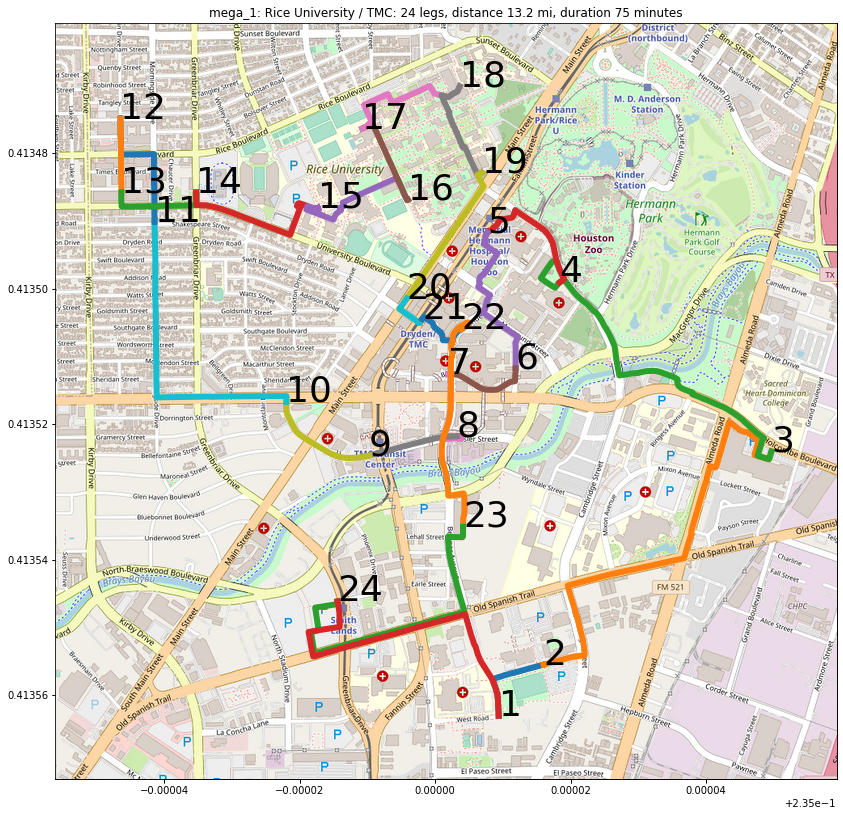

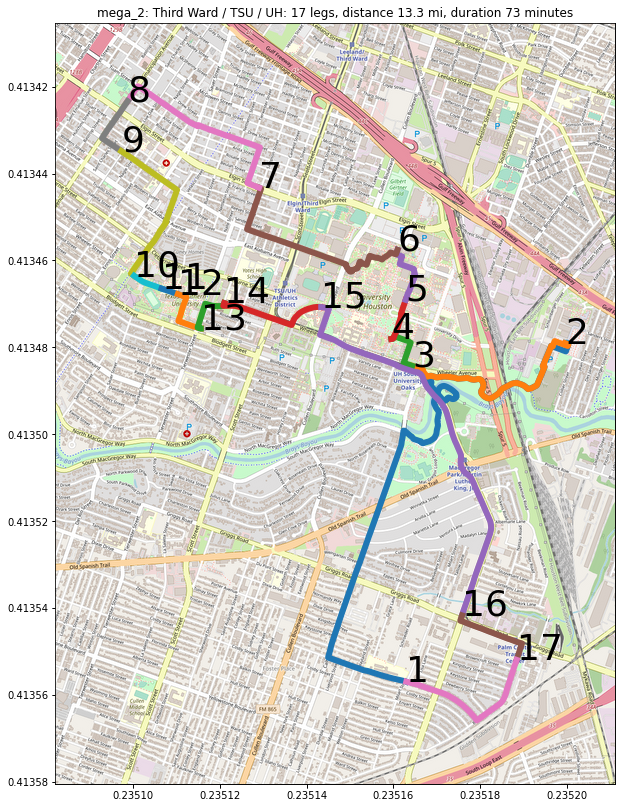

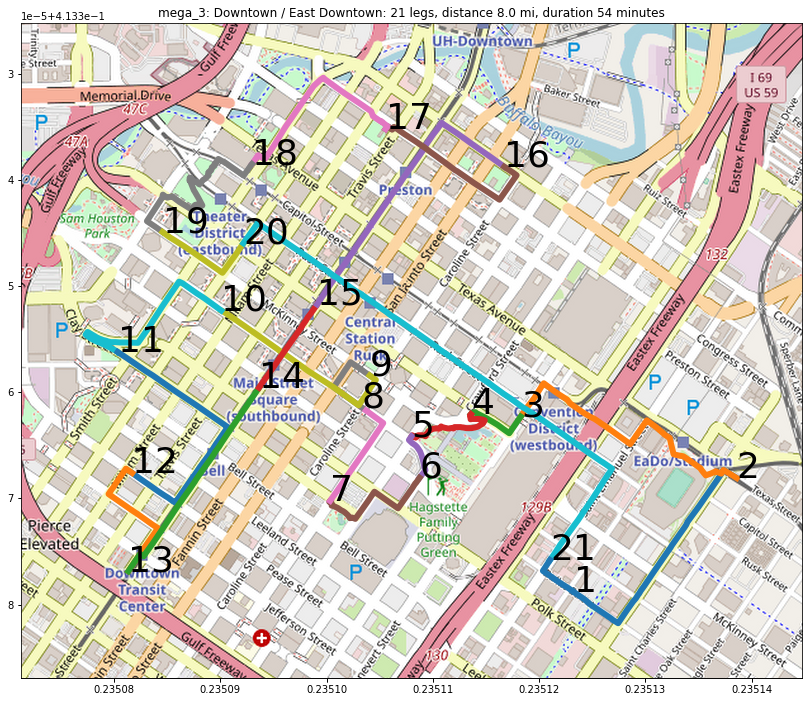

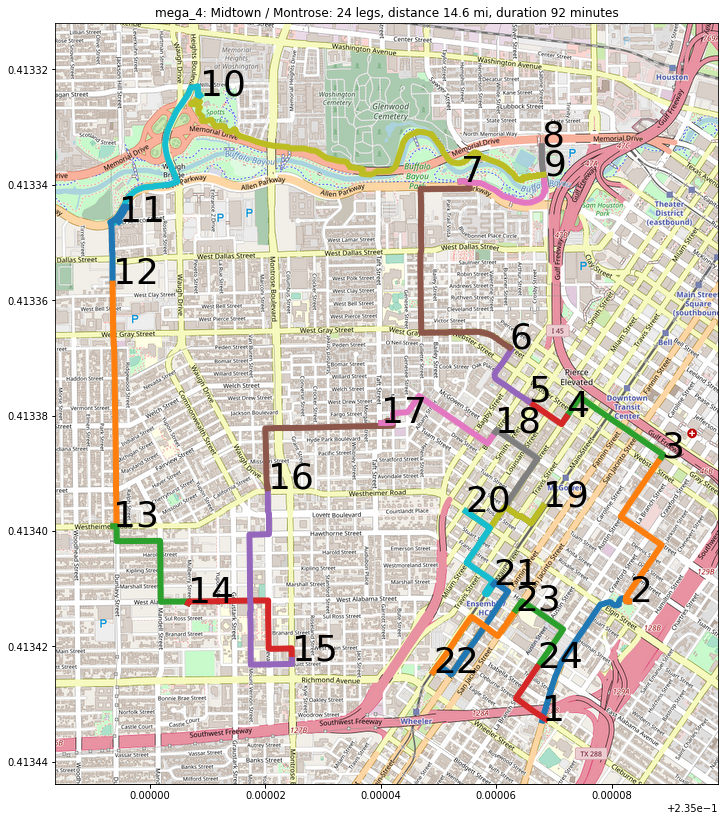

In [91]:
# Calculate the routes, distances, durations, orderings, etc for the biggest circuits
mega_dist, mega_dur, mega_stats = 0, 0, 0
mega_orderings = []

for idx in range(len(mega_groups)):
    df2 = df[df.N2.isin(mega_groups[idx])]
    dist, dur, stats, order = obtain_and_plot_waypoints(df2, label='mega_%d' % idx, force=False)
    
    mega_dist += dist
    mega_dur += dur
    mega_stats += stats
    mega_orderings.append(order)

loading cache 483eb05f430c50a683b5d7eb1dbd1225
Total distance: 13.214 mi
Total duration: 75 minutes
saving sparse_0
loading cache 80a50c8db1ba7e346ae0620eabf0c1de
Total distance: 17.415 mi
Total duration: 99 minutes
saving sparse_1
loading cache f532caa53727abd63257e76bd6205f09
Total distance: 4.929 mi
Total duration: 24 minutes
saving sparse_2
loading cache 0c6977ecd5c812b1d4cbbaef808ad1f1
Total distance: 4.163 mi
Total duration: 20 minutes
saving sparse_3
loading cache 0fe82e2588e400afe3a2ed5ac68e3e3c
Total distance: 8.559 mi
Total duration: 46 minutes
saving sparse_4


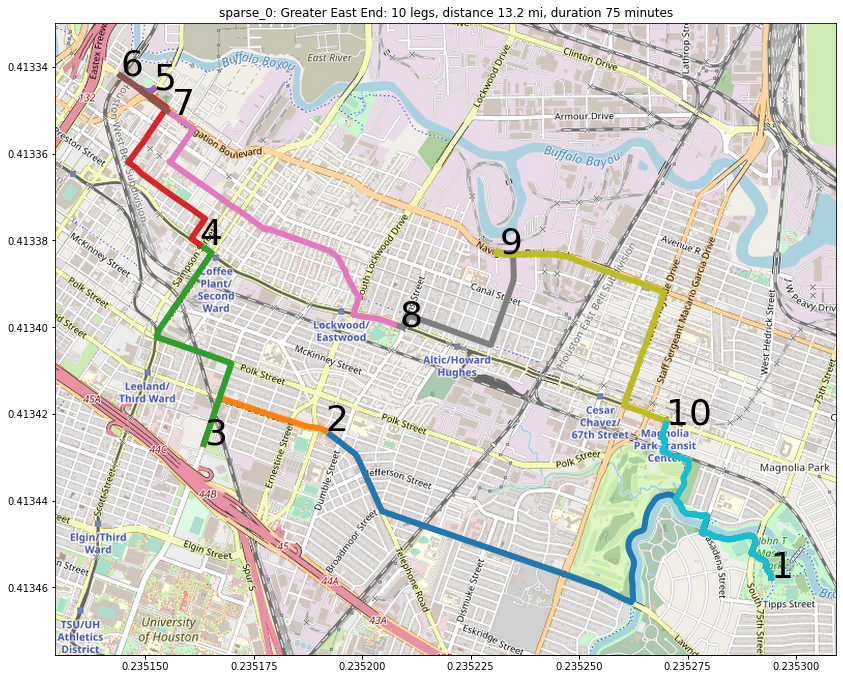

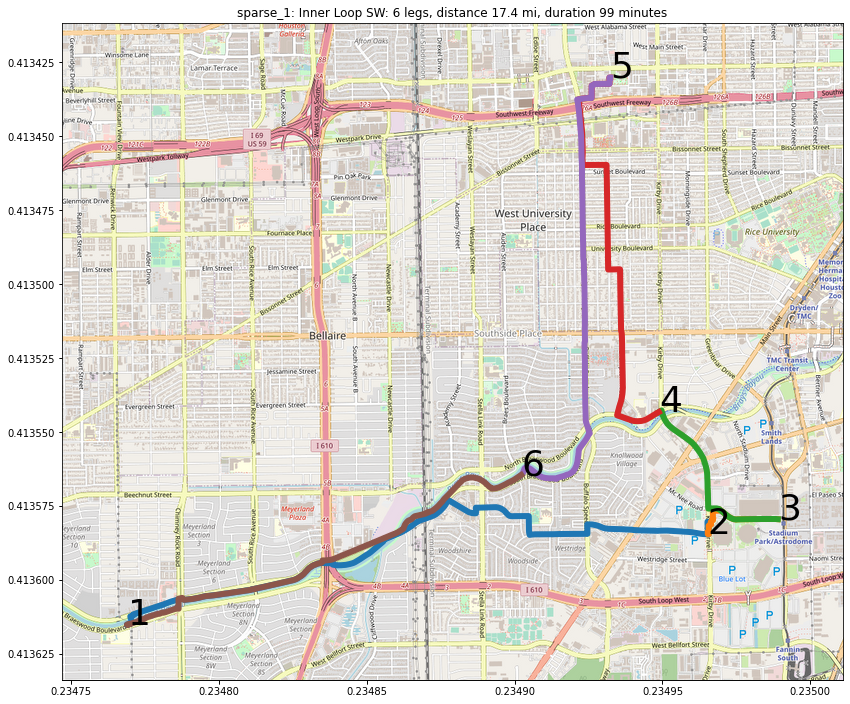

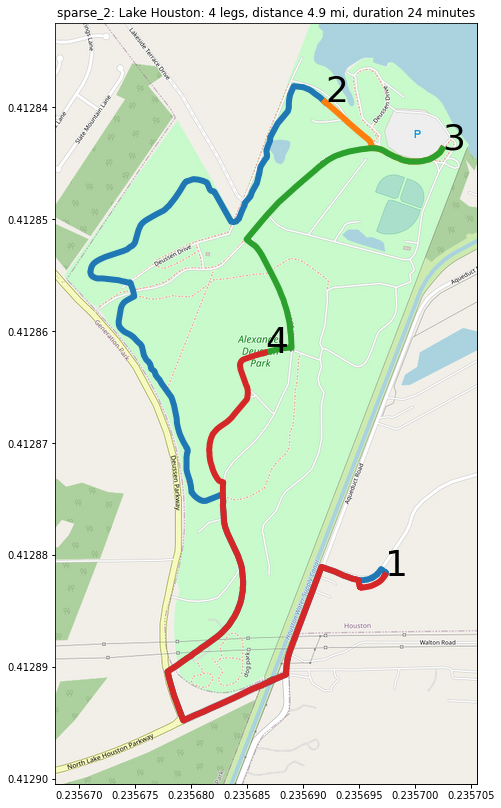

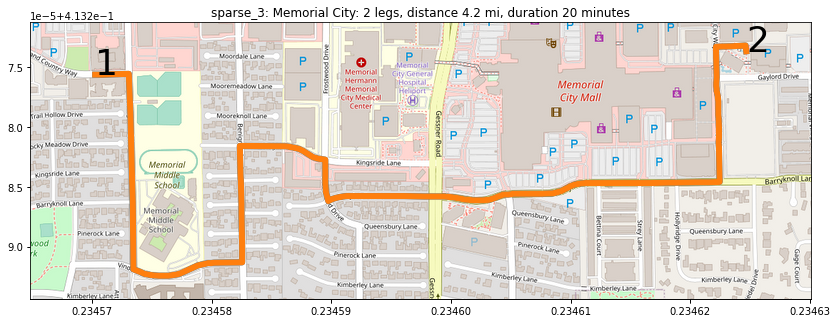

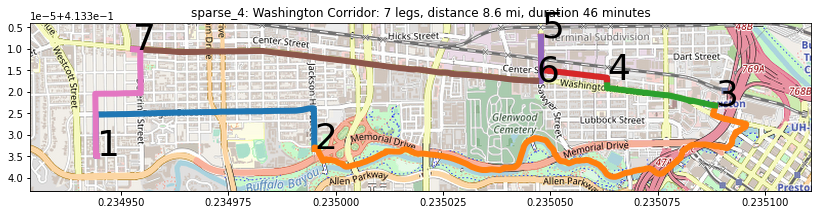

In [92]:
sparse_dist, sparse_dur, sparse_stats = 0, 0, 0
sparse_orderings = []

for idx in range(len(sparse_groups)):
    df2 = df[df.N2.isin(sparse_groups[idx])]
    dist, dur, stats, order = obtain_and_plot_waypoints(df2, label='sparse_%d' % idx, force=False)
    sparse_dist += dist
    sparse_dur += dur
    sparse_stats += stats
    sparse_orderings.append(order)


In [ ]:
special_dist, special_dur, special_stats = 0, 0, 0
special_orderings = []

for idx in range(len(special_groups)):
    df2 = df[df.N2.isin(special_groups[idx])]
    dist, dur, stats,order = obtain_and_plot_waypoints(df2, label='special_%d' % idx, force=False)
    special_dist += dist
    special_dur += dur
    special_stats += stats
    
    special_orderings.append(order)

#     break

loading cache 175beed7735e29f26196a6ed71f22ed5
Total distance: 10.025 mi
Total duration: 55 minutes
saving special_0
loading cache cb9f56a1fac7c42dace305bc27f6fd29
Total distance: 5.438 mi
Total duration: 30 minutes
saving special_1
loading cache 0c6fd705d89f22a43b021496d87e2ba5
Total distance: 5.107 mi
Total duration: 29 minutes
saving special_2


In [ ]:
special_dist + mega_dist+ sparse_dist, (special_dur + mega_dur+sparse_dur)/60.0, special_stats+mega_stats+sparse_stats

In [ ]:
# To complete the solely by bike TourdeBCycle, you have to bike ~132 miles, which will take at least 13 hours.

In [ ]:
# Data for links to group pages:
group_names = [
    'fifthward_northside_uhd',
    'rice_tmc',
    'third_ward_tsu_uh',
    'downtown_eado',
    'midtown_montrose',
    'heights',
    'hermann_park_museum',
    'memorial_park',
    'greater_east_end',
    'inner_loop_sw',
    'lake_houston',
    'memorial_city',
    'washington_corridor',
]

# Special notes for some circuits
group_notes = [
    '',
    '',
    '',
    '',
    '',
    '',
    '',
    'Note: These paths are unrealistic due to construction... use your best judgement!!!',
    '',
    'Note: Levy park is kind of an outlier -- perhaps it should be conquered separately, ie with Rice/TMC',
    '',
    '',
    '',
]

# quick name for each group
group_tags = [
    'mega_0',
    'mega_1',
    'mega_2',
    'mega_3',
    'mega_4',
    'special_0',
    'special_1',
    'special_2',
    'sparse_0',
    'sparse_1',
    'sparse_2',
    'sparse_3',
    'sparse_4',
]

# circuit definitions using previously defined sets
inclusion = [
    mega_groups[0],
    mega_groups[1],
    mega_groups[2],
    mega_groups[3],
    mega_groups[4],
    special_groups[0],
    special_groups[1],
    special_groups[2],
    sparse_groups[0],
    sparse_groups[1],
    sparse_groups[2],
    sparse_groups[3],
    sparse_groups[4],
]

# Waypoint orderings were calculated by the obtain_and_plot_waypoints function above
waypoint_orderings = [
    mega_orderings[0],
    mega_orderings[1],
    mega_orderings[2],
    mega_orderings[3],
    mega_orderings[4],
    special_orderings[0],
    special_orderings[1],
    special_orderings[2],
    sparse_orderings[0],
    sparse_orderings[1],
    sparse_orderings[2],
    sparse_orderings[3],
    sparse_orderings[4],
]

In [ ]:
# Render main page
environment = jinja2.Environment(loader=jinja2.FileSystemLoader("web")) # "bcycle_data/website/"
template = environment.get_template("big.template")

filename = "web/big.html"
table_data = [
        {
            'number':n, 
            'name': f'<a href="{tag}.html">{tag}</a>'} for n,tag in enumerate(group_names)
    ]
content = template.render(
    {'group': table_data}, img_name='images/big.jpg',
)
with open(filename, mode="w", encoding="utf-8") as message:
    message.write(content)
    print(f"... wrote {filename}")

In [ ]:
# Render pages for circuits

environment = jinja2.Environment(loader=jinja2.FileSystemLoader("web")) # "bcycle_data/website/"
template = environment.get_template("cycle.template")

for name, note, tag, ordering, included in zip(group_names, group_notes, group_tags, waypoint_orderings, inclusion ):
    filename = f"web/{name}.html"
    
    df2 = df[df.N2.isin(included)]
    
    ordered_waypoints = permute_stations(df2, ordering)
    
    # render data for the table of stations, including a GPS link for Apple and Google maps
    table_data = [{
        'number':n+1, 
        'name': row.Name, 
        'neighborhood': row.N2, 
        'apple':f'<a href="http://maps.apple.com/?q={row.Lat},{row.Lon}">Apple</a>',
        'google':f'<a href="https://www.google.com/maps/dir/?api=1&destination={row.Lat},{row.Lon}">Google</a>',
        'Lat':row.Lat, 'Lon':row.Lon} 
                  for n,row in enumerate(ordered_waypoints) ]
    content = template.render(
        {'group': table_data,}, img_name=f'images/{tag}.jpg', note=note, usenote=len(note)>0,
    )

    with open(filename, mode="w", encoding="utf-8") as message:
        message.write(content)
        print(f"wrote {filename}")
    